In [195]:
#Basic and most imp libraries
import pandas as pd , numpy as np
from sklearn.utils import resample
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from collections import Counter
from scipy import stats
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
pd.set_option("display.max_row",None)
pd.set_option("display.max_columns",None)
import plotly.express as px
import plotly.figure_factory as ff
import plotly

#Classifiers
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier, VotingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier

from sklearn.svm import SVR
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from xgboost import plot_importance
from xgboost import XGBClassifier
from sklearn.svm import SVC

#Model evaluation tools
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn import model_selection
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()

import warnings 
warnings.filterwarnings("ignore")

In [196]:
df=pd.read_csv("h1n1_vaccine_prediction.csv")

In [197]:
#default theme
sns.set_theme(palette='tab10',
             font='sans-serif',
             font_scale=1.0,
             )
import matplotlib
matplotlib.rcParams.update({'font.size':10})
plt.style.use('dark_background')

## Data Visualization

In [198]:
df.sample(10).style.background_gradient(cmap='coolwarm')

,unique_id,h1n1_worry,h1n1_awareness,antiviral_medication,contact_avoidance,bought_face_mask,wash_hands_frequently,avoid_large_gatherings,reduced_outside_home_cont,avoid_touch_face,dr_recc_h1n1_vacc,dr_recc_seasonal_vacc,chronic_medic_condition,cont_child_undr_6_mnths,is_health_worker,has_health_insur,is_h1n1_vacc_effective,is_h1n1_risky,sick_from_h1n1_vacc,is_seas_vacc_effective,is_seas_risky,sick_from_seas_vacc,age_bracket,qualification,race,sex,income_level,marital_status,housing_status,employment,census_msa,no_of_adults,no_of_children,h1n1_vaccine
18897,18897,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,4.000000,1.000000,1.000000,4.000000,2.000000,1.000000,35 - 44 Years,College Graduate,White,Male,"> $75,000",Married,Own,Employed,"MSA, Not Principle City",1.000000,2.000000,0
18299,18299,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,3.000000,4.000000,4.000000,5.000000,4.000000,1.000000,18 - 34 Years,Some College,White,Female,nan,Married,Own,Not in Labor Force,Non-MSA,1.000000,2.000000,0
10006,10006,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,nan,4.000000,1.000000,4.000000,4.000000,1.000000,1.000000,55 - 64 Years,12 Years,White,Male,"<= $75,000, Above Poverty",Married,Own,Employed,"MSA, Not Principle City",1.000000,0.000000,0
24180,24180,2.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,2.000000,2.000000,3.000000,2.000000,4.000000,65+ Years,12 Years,White,Male,"<= $75,000, Above Poverty",Married,Own,Not in Labor Force,Non-MSA,0.000000,0.000000,0
6845,6845,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,18 - 34 Years,College Graduate,Hispanic,Female,"<= $75,000, Above Poverty",Married,Own,Not in Labor Force,"MSA, Principle City",1.000000,2.000000,0
10643,10643,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,nan,3.000000,1.000000,1.000000,5.000000,2.000000,4.000000,18 - 34 Years,College Graduate,White,Male,"> $75,000",Married,Own,Employed,"MSA, Not Principle City",1.000000,0.000000,0
894,894,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,nan,4.000000,2.000000,1.000000,4.000000,2.000000,1.000000,65+ Years,College Graduate,Black,Male,"> $75,000",Married,Own,Employed,"MSA, Not Principle City",1.000000,0.000000,0
20359,20359,3.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,2.000000,2.000000,3.000000,3.000000,4.000000,55 - 64 Years,Some College,Black,Female,Below Poverty,Not Married,Rent,Not in Labor Force,"MSA, Principle City",0.000000,0.000000,0
3033,3033,3.000000,2.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,2.000000,1.000000,2.000000,4.000000,2.000000,1.000000,45 - 54 Years,College Graduate,White,Female,"<= $75,000, Above Poverty",Married,Own,Not in Labor Force,"MSA, Principle City",2.000000,0.000000,0
2391,2391,1.000000,2.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,nan,3.000000,2.000000,2.000000,4.000000,4.000000,5.000000,55 - 64 Years,12 Years,White,Female,"<= $75,000, Above Poverty",Married,Own,Not in Labor Force,"MSA, Principle City",1.000000,0.000000,0


In [199]:
df.shape

(26707, 34)

In [200]:
df.describe().style.background_gradient(cmap='rainbow')

,unique_id,h1n1_worry,h1n1_awareness,antiviral_medication,contact_avoidance,bought_face_mask,wash_hands_frequently,avoid_large_gatherings,reduced_outside_home_cont,avoid_touch_face,dr_recc_h1n1_vacc,dr_recc_seasonal_vacc,chronic_medic_condition,cont_child_undr_6_mnths,is_health_worker,has_health_insur,is_h1n1_vacc_effective,is_h1n1_risky,sick_from_h1n1_vacc,is_seas_vacc_effective,is_seas_risky,sick_from_seas_vacc,no_of_adults,no_of_children,h1n1_vaccine
count,26707.000000,26615.000000,26591.000000,26636.000000,26499.000000,26688.000000,26665.000000,26620.000000,26625.000000,26579.000000,24547.000000,24547.000000,25736.000000,25887.000000,25903.000000,14433.000000,26316.000000,26319.000000,26312.000000,26245.000000,26193.000000,26170.000000,26458.000000,26458.000000,26707.000000
mean,13353.000000,1.618486,1.262532,0.048844,0.725612,0.068982,0.825614,0.358640,0.337315,0.677264,0.220312,0.329735,0.283261,0.082590,0.111918,0.879720,3.850623,2.342566,2.357670,4.025986,2.719162,2.118112,0.886499,0.534583,0.212454
std,7709.791156,0.910311,0.618149,0.215545,0.446214,0.253429,0.379448,0.479610,0.472802,0.467531,0.414466,0.470126,0.450591,0.275266,0.315271,0.325300,1.007436,1.285539,1.362766,1.086565,1.385055,1.332950,0.753422,0.928173,0.409052
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000
25%,6676.500000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,1.000000,1.000000,4.000000,2.000000,1.000000,0.000000,0.000000,0.000000
50%,13353.000000,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,4.000000,2.000000,2.000000,4.000000,2.000000,2.000000,1.000000,0.000000,0.000000
75%,20029.500000,2.000000,2.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,5.000000,4.000000,4.000000,5.000000,4.000000,4.000000,1.000000,1.000000,0.000000
max,26706.000000,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000,3.000000,1.000000


In [201]:
df.columns

Index(['unique_id', 'h1n1_worry', 'h1n1_awareness', 'antiviral_medication',
       'contact_avoidance', 'bought_face_mask', 'wash_hands_frequently',
       'avoid_large_gatherings', 'reduced_outside_home_cont',
       'avoid_touch_face', 'dr_recc_h1n1_vacc', 'dr_recc_seasonal_vacc',
       'chronic_medic_condition', 'cont_child_undr_6_mnths',
       'is_health_worker', 'has_health_insur', 'is_h1n1_vacc_effective',
       'is_h1n1_risky', 'sick_from_h1n1_vacc', 'is_seas_vacc_effective',
       'is_seas_risky', 'sick_from_seas_vacc', 'age_bracket', 'qualification',
       'race', 'sex', 'income_level', 'marital_status', 'housing_status',
       'employment', 'census_msa', 'no_of_adults', 'no_of_children',
       'h1n1_vaccine'],
      dtype='object')

In [202]:
categorical_columns = ['age_bracket', 'qualification',
       'race', 'sex', 'income_level', 'marital_status', 'housing_status',
       'employment', 'census_msa']

fig, axes = plt.subplots(4,2,figsize=(12,15))

for column in categorical_columns:
    plt.figure(figsize=(6,3))
    sns.countplot(x=column,data=df)
    
plt.subplots_adjust(hspace=1)
plt.show()

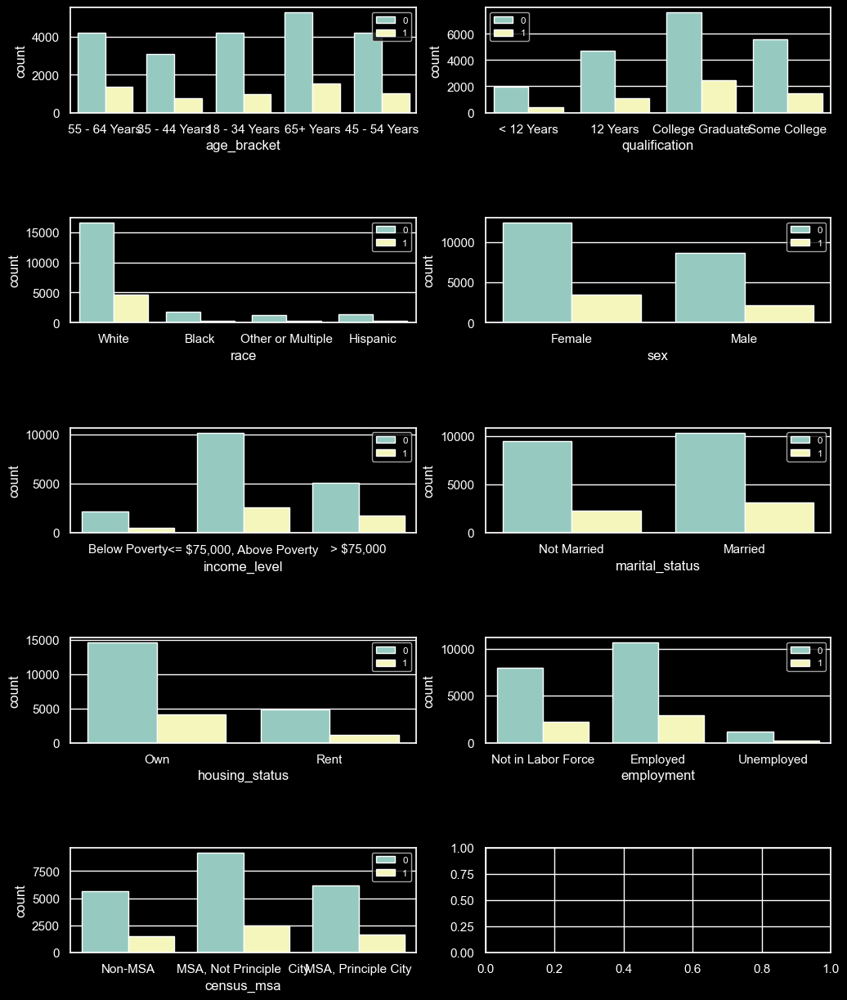

In [203]:
num_columns = len(categorical_columns)
num_rows = (num_columns + 1) // 2


fig, axes = plt.subplots(num_rows, 2, figsize=(12, 3 * num_rows))

for idx, cat_col in enumerate(categorical_columns):
    row, col = idx // 2, idx % 2
    sns.countplot(x=cat_col, data=df, hue='h1n1_vaccine', ax=axes[row, col])
    axes[row, col].legend(fontsize='small') #set the fontsize for the legend
    
plt.subplots_adjust(hspace=1)   
plt.show()

In [204]:
numerical_columns=['h1n1_worry', 'h1n1_awareness', 'antiviral_medication',
       'contact_avoidance', 'bought_face_mask', 'wash_hands_frequently',
       'avoid_large_gatherings', 'reduced_outside_home_cont',
       'avoid_touch_face', 'dr_recc_h1n1_vacc', 'dr_recc_seasonal_vacc',
       'chronic_medic_condition', 'cont_child_undr_6_mnths',
       'is_health_worker', 'has_health_insur', 'is_h1n1_vacc_effective',
       'is_h1n1_risky', 'sick_from_h1n1_vacc', 'is_seas_vacc_effective',
       'is_seas_risky', 'sick_from_seas_vacc','no_of_adults', 'no_of_children',
       'h1n1_vaccine']

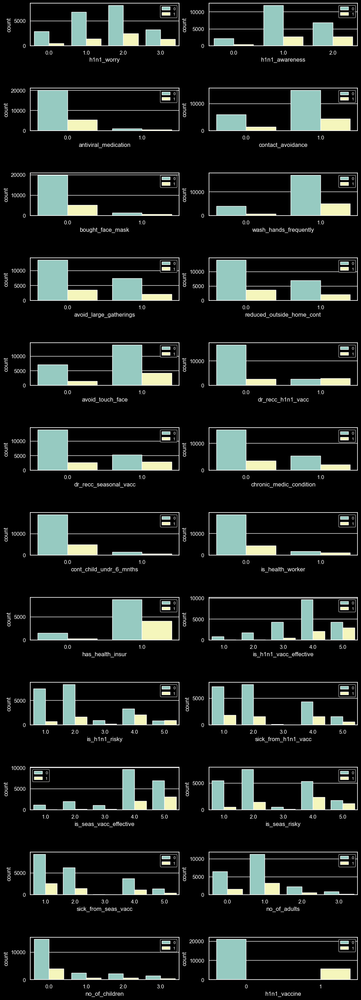

In [205]:
num_columns = len(numerical_columns)
num_rows = (num_columns + 1) // 2


fig, axes = plt.subplots(num_rows, 2, figsize=(12, 3 * num_rows))

for idx, cat_col in enumerate(numerical_columns):
    row, col = idx // 2, idx % 2
    sns.countplot(x=cat_col, data=df, hue='h1n1_vaccine', ax=axes[row, col])
    axes[row, col].legend(fontsize='small') #set the fontsize for the legend
    
plt.subplots_adjust(hspace=1)
plt.show()

<Axes: >

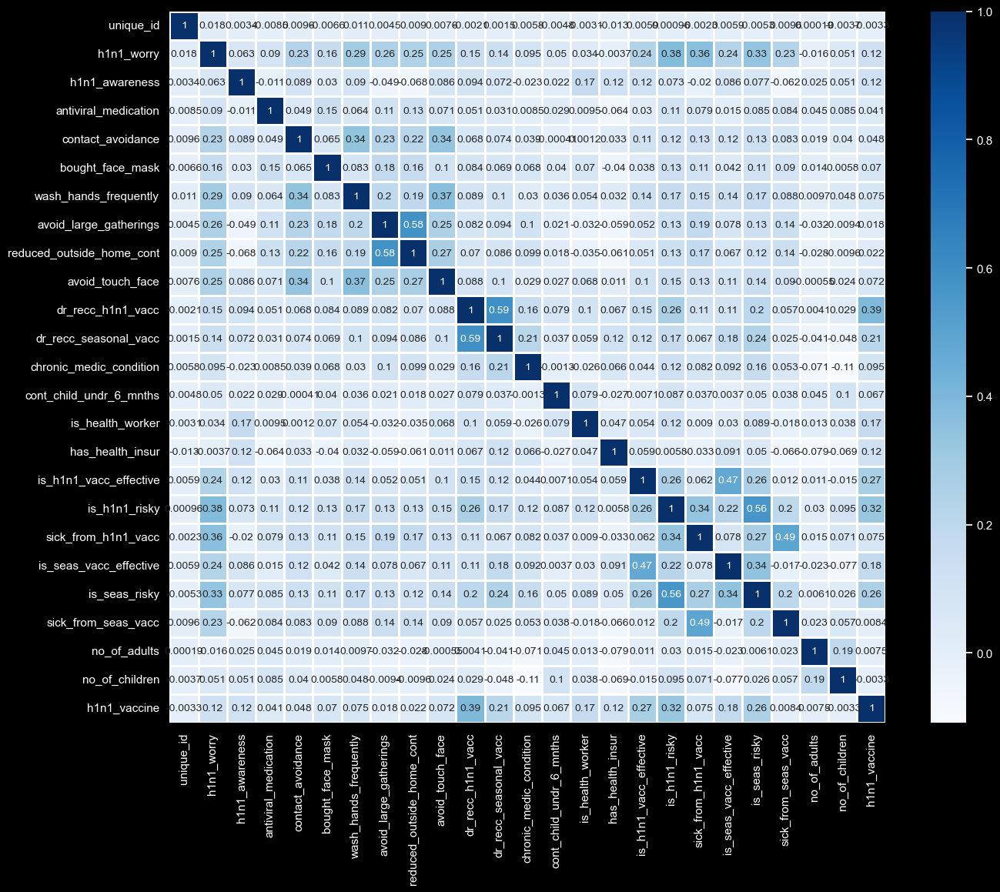

In [206]:
numeric_data = df.select_dtypes(include=['float64', 'int64'])
correlation_mat = numeric_data.corr()
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(correlation_mat, annot=True,linewidths=2, cmap="Blues")

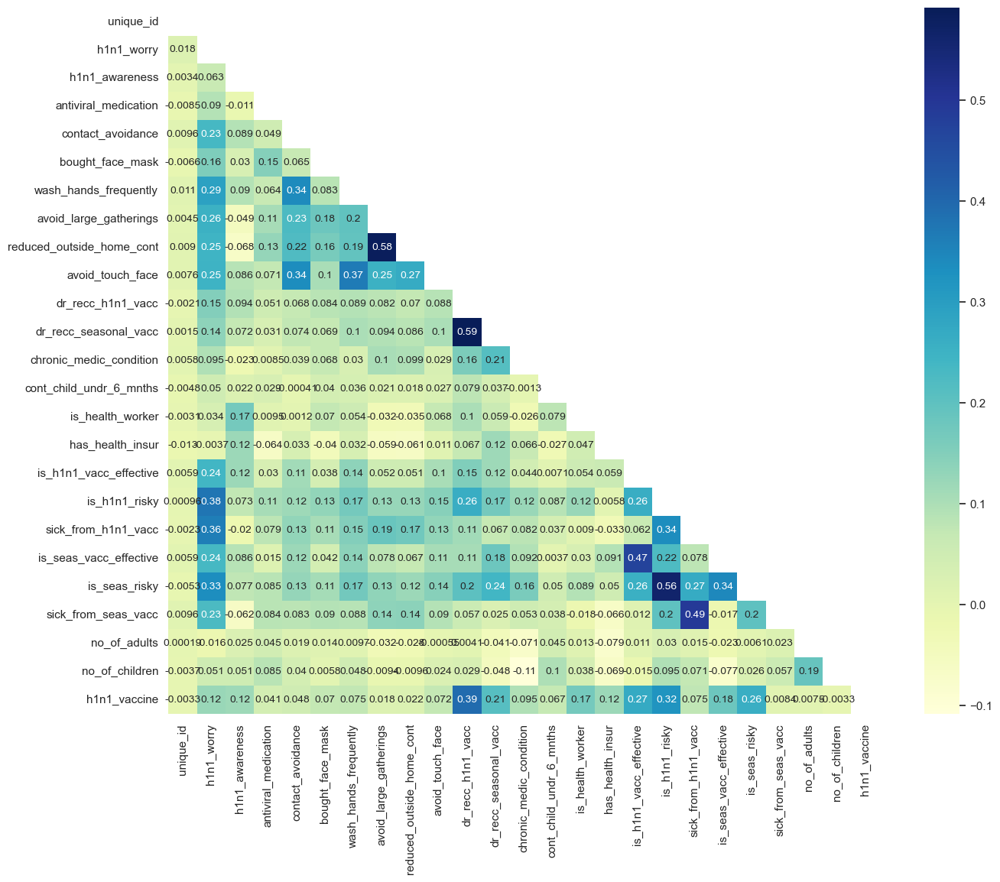

In [207]:
mask=np.zeros_like(correlation_mat)
mask[np.triu_indices_from(mask)]=True
with sns.axes_style("white"):
    f,ax = plt.subplots(figsize=(15,12))
    ax = sns.heatmap(correlation_mat, mask=mask,annot=True,cmap="YlGnBu")

<Axes: >

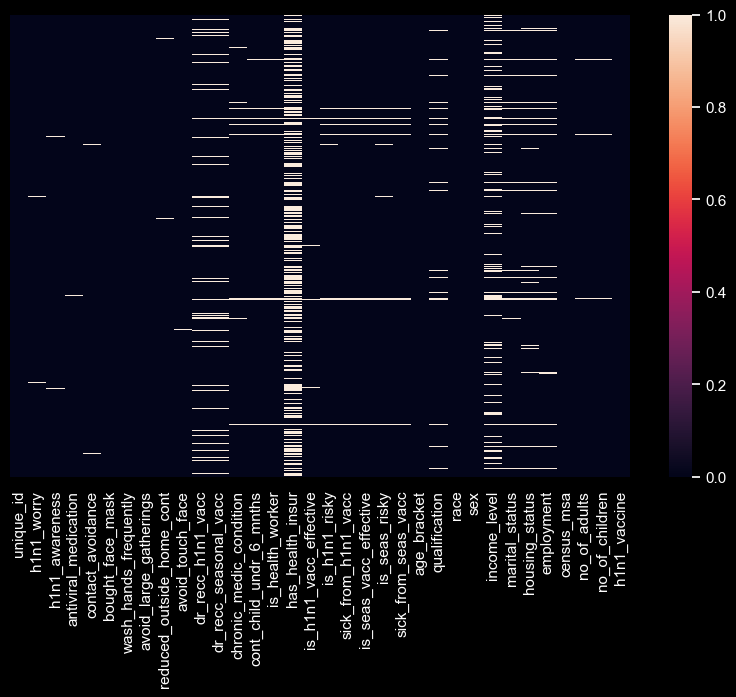

In [208]:
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(),yticklabels=False)

In [209]:
for column in numerical_columns:
    fig = px.histogram(df, x=column, title=f'Histogram for {column}')
    fig.show()

In [210]:
def print_statistics(column_name, values):
    print(f"Mean->{column_name}: {values.mean()}")
    print(f"Mode->{column_name}: {values.mode()[0]}")  # Assuming mode is unique
    print(f"Median->{column_name}: {values.median()}")
    print(f"Standard Deviation->{column_name}: {values.std()}")
    print("\n")

# Calculate and print statistics for each numerical column
for column in numerical_columns:
    values = df[column].describe()
    print_statistics(column, values)

Mean->h1n1_worry: 3328.1910995632034
Mode->h1n1_worry: 2.0
Median->h1n1_worry: 1.8092429081345105
Standard Deviation->h1n1_worry: 9409.291748710559


Mean->h1n1_awareness: 3324.860085196184
Mode->h1n1_awareness: 1.0
Median->h1n1_awareness: 1.1312662178932722
Standard Deviation->h1n1_awareness: 9400.940198322493


Mean->antiviral_medication: 3329.658048602138
Mode->antiviral_medication: 0.0
Median->antiviral_medication: 0.024421835110376933
Standard Deviation->antiviral_medication: 9417.184256786537


Mean->contact_avoidance: 3312.896478240495
Mode->contact_avoidance: 1.0
Median->contact_avoidance: 0.8628061436280614
Standard Deviation->contact_avoidance: 9368.600597751389


Mean->bought_face_mask: 3336.165301390346
Mode->bought_face_mask: 0.0
Median->bought_face_mask: 0.03449115707434053
Standard Deviation->bought_face_mask: 9435.56610250642


Mean->wash_hands_frequently: 3333.7756327745064
Mode->wash_hands_frequently: 1.0
Median->wash_hands_frequently: 1.0
Standard Deviation->wash_han

In [211]:
for column in numerical_columns:
    fig = px.histogram(df, x=column, title=f'Histogram for {column}')
    fig.show()

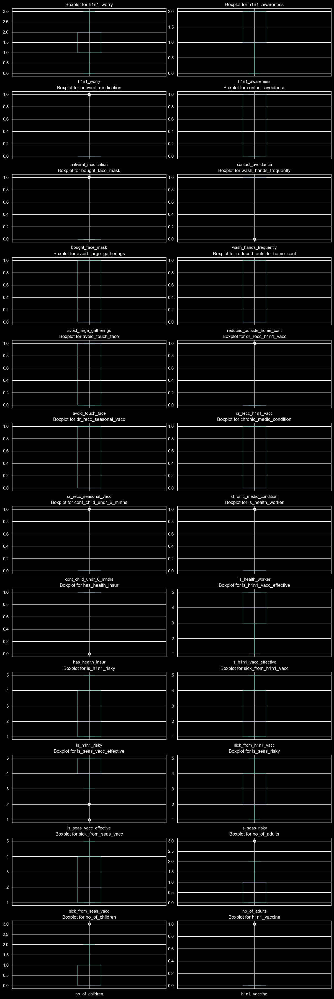

In [212]:
num_columns = len(numerical_columns)
num_rows = (num_columns + 1) // 2

fig, axes = plt.subplots(num_rows, 2, figsize=(12, 3 * num_rows))

for idx, column in enumerate(numerical_columns[:num_rows * 2]):  
    row, col = idx // 2, idx % 2
    plt.subplot(num_rows, 2, idx + 1)
    df[column].plot.box()
    plt.title(f'Boxplot for {column}')
    plt.tight_layout(pad=0.5)

plt.show()

No Outliers

In [213]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26707 entries, 0 to 26706
Data columns (total 34 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   unique_id                  26707 non-null  int64  
 1   h1n1_worry                 26615 non-null  float64
 2   h1n1_awareness             26591 non-null  float64
 3   antiviral_medication       26636 non-null  float64
 4   contact_avoidance          26499 non-null  float64
 5   bought_face_mask           26688 non-null  float64
 6   wash_hands_frequently      26665 non-null  float64
 7   avoid_large_gatherings     26620 non-null  float64
 8   reduced_outside_home_cont  26625 non-null  float64
 9   avoid_touch_face           26579 non-null  float64
 10  dr_recc_h1n1_vacc          24547 non-null  float64
 11  dr_recc_seasonal_vacc      24547 non-null  float64
 12  chronic_medic_condition    25736 non-null  float64
 13  cont_child_undr_6_mnths    25887 non-null  flo

## Data Cleaning

In [214]:
df["h1n1_worry"]=df["h1n1_worry"].replace(np.NaN,df['h1n1_worry'].median())
df["h1n1_awareness"]=df["h1n1_awareness"].replace(np.NaN,df['h1n1_awareness'].median())
df["antiviral_medication"]=df["antiviral_medication"].replace(np.NaN,df['antiviral_medication'].median())
df["contact_avoidance"]=df["contact_avoidance"].replace(np.NaN,df['contact_avoidance'].median())
df["bought_face_mask"]=df["bought_face_mask"].replace(np.NaN,df['bought_face_mask'].median())
df["wash_hands_frequently"]=df["wash_hands_frequently"].replace(np.NaN,df['wash_hands_frequently'].median())
df["avoid_large_gatherings"]=df["avoid_large_gatherings"].replace(np.NaN,df['avoid_large_gatherings'].median())
df["reduced_outside_home_cont"]=df["reduced_outside_home_cont"].replace(np.NaN,df['reduced_outside_home_cont'].median())
df["avoid_touch_face"]=df["avoid_touch_face"].replace(np.NaN,df['avoid_touch_face'].median())
df["dr_recc_h1n1_vacc"]=df["dr_recc_h1n1_vacc"].replace(np.NaN,df['dr_recc_h1n1_vacc'].median())
df["dr_recc_seasonal_vacc"]=df["dr_recc_seasonal_vacc"].replace(np.NaN,df['dr_recc_seasonal_vacc'].median())
df["chronic_medic_condition"]=df["chronic_medic_condition"].replace(np.NaN,df['chronic_medic_condition'].median())
df["cont_child_undr_6_mnths"]=df["cont_child_undr_6_mnths"].replace(np.NaN,df['cont_child_undr_6_mnths'].median())
df["is_health_worker"]=df["is_health_worker"].replace(np.NaN,df['is_health_worker'].median())
df["has_health_insur"]=df["has_health_insur"].replace(np.NaN,df['has_health_insur'].median())
df["is_h1n1_vacc_effective"]=df["is_h1n1_vacc_effective"].replace(np.NaN,df['is_h1n1_vacc_effective'].median())
df["is_h1n1_risky"]=df["is_h1n1_risky"].replace(np.NaN,df['is_h1n1_risky'].median())
df["sick_from_h1n1_vacc"]=df["sick_from_h1n1_vacc"].replace(np.NaN,df['sick_from_h1n1_vacc'].median())
df["is_seas_vacc_effective"]=df["is_seas_vacc_effective"].replace(np.NaN,df['is_seas_vacc_effective'].median())
df["is_seas_risky"]=df["is_seas_risky"].replace(np.NaN,df['is_seas_risky'].median())
df["sick_from_seas_vacc"]=df["sick_from_seas_vacc"].replace(np.NaN,df['sick_from_seas_vacc'].median())
df["is_health_worker"]=df["is_health_worker"].replace(np.NaN,df['is_health_worker'].median())

df["qualification"]=df["qualification"].replace(np.NaN,df['qualification'].mode()[0])
df["income_level"]=df["income_level"].replace(np.NaN,df['income_level'].mode()[0])
df["marital_status"]=df["marital_status"].replace(np.NaN,df['marital_status'].mode()[0])
df["housing_status"]=df["housing_status"].replace(np.NaN,df['housing_status'].mode()[0])
df["employment"]=df["employment"].replace(np.NaN,df['employment'].mode()[0])
df["no_of_adults"]=df["no_of_adults"].replace(np.NaN,df['no_of_adults'].mode()[0])
df["no_of_children"]=df["no_of_children"].replace(np.NaN,df['no_of_children'].mode()[0])


#### Normalising the distribution

In [215]:
df["h1n1_worry"]=[np.log(i) if i!=0 else 0 for i in df["h1n1_worry"]]
df["h1n1_awareness"]=[np.log(i) if i!=0 else 0 for i in df["h1n1_awareness"]]
df["antiviral_medication"]=[np.log(i) if i!=0 else 0 for i in df["antiviral_medication"]]
df["contact_avoidance"]=[np.log(i) if i!=0 else 0 for i in df["contact_avoidance"]]
df["bought_face_mask"]=[np.log(i) if i!=0 else 0 for i in df["bought_face_mask"]]
df["wash_hands_frequently"]=[np.log(i) if i!=0 else 0 for i in df["wash_hands_frequently"]]
df["avoid_large_gatherings"]=[np.log(i) if i!=0 else 0 for i in df["avoid_large_gatherings"]]
df["reduced_outside_home_cont"]=[np.log(i) if i!=0 else 0 for i in df["reduced_outside_home_cont"]]
df["avoid_touch_face"]=[np.log(i) if i!=0 else 0 for i in df["avoid_touch_face"]]
df["dr_recc_h1n1_vacc"]=[np.log(i) if i!=0 else 0 for i in df["dr_recc_h1n1_vacc"]]
df["dr_recc_seasonal_vacc"]=[np.log(i) if i!=0 else 0 for i in df["dr_recc_seasonal_vacc"]]
df["chronic_medic_condition"]=[np.log(i) if i!=0 else 0 for i in df["chronic_medic_condition"]]
df["cont_child_undr_6_mnths"]=[np.log(i) if i!=0 else 0 for i in df["cont_child_undr_6_mnths"]]
df["has_health_insur"]=[np.log(i) if i!=0 else 0 for i in df["has_health_insur"]]
df["is_h1n1_vacc_effective"]=[np.log(i) if i!=0 else 0 for i in df["is_h1n1_vacc_effective"]]
df["is_h1n1_risky"]=[np.log(i) if i!=0 else 0 for i in df["is_h1n1_risky"]]
df["sick_from_h1n1_vacc"]=[np.log(i) if i!=0 else 0 for i in df["sick_from_h1n1_vacc"]]
df["is_seas_vacc_effective"]=[np.log(i) if i!=0 else 0 for i in df["is_seas_vacc_effective"]]
df["is_seas_risky"]=[np.log(i) if i!=0 else 0 for i in df["is_seas_risky"]]
df["sick_from_seas_vacc"]=[np.log(i) if i!=0 else 0 for i in df["sick_from_seas_vacc"]]
df["no_of_children"]=[np.log(i) if i!=0 else 0 for i in df["no_of_children"]]
df["no_of_adults"]=[np.log(i) if i!=0 else 0 for i in df["no_of_adults"]]

<Axes: >

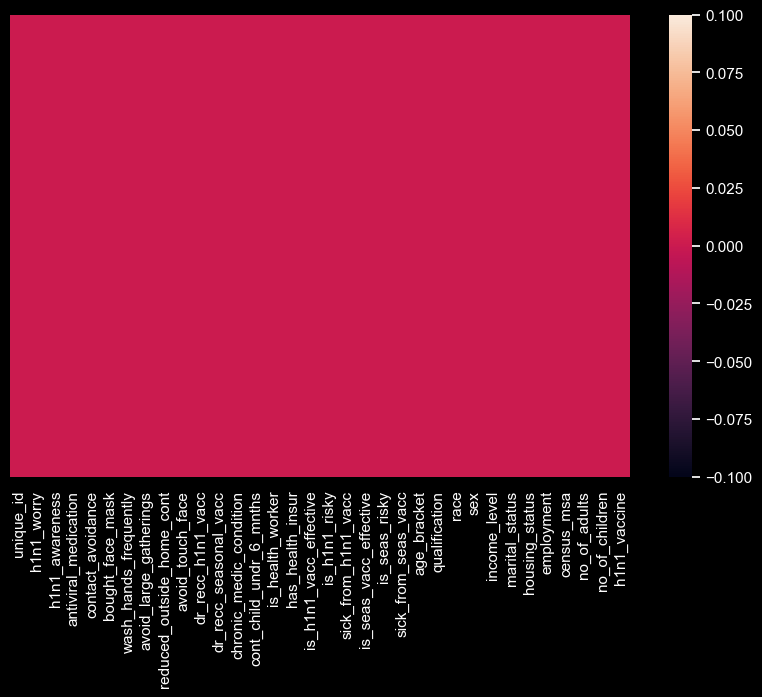

In [216]:
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(),yticklabels=False)

In [283]:
duplicate=df.duplicated()
print(duplicate.sum())

0


In [217]:
df.isnull().sum()

unique_id                    0
h1n1_worry                   0
h1n1_awareness               0
antiviral_medication         0
contact_avoidance            0
bought_face_mask             0
wash_hands_frequently        0
avoid_large_gatherings       0
reduced_outside_home_cont    0
avoid_touch_face             0
dr_recc_h1n1_vacc            0
dr_recc_seasonal_vacc        0
chronic_medic_condition      0
cont_child_undr_6_mnths      0
is_health_worker             0
has_health_insur             0
is_h1n1_vacc_effective       0
is_h1n1_risky                0
sick_from_h1n1_vacc          0
is_seas_vacc_effective       0
is_seas_risky                0
sick_from_seas_vacc          0
age_bracket                  0
qualification                0
race                         0
sex                          0
income_level                 0
marital_status               0
housing_status               0
employment                   0
census_msa                   0
no_of_adults                 0
no_of_ch

# Encoding

In [218]:
df['age_bracket'].value_counts()

age_bracket
65+ Years        6843
55 - 64 Years    5563
45 - 54 Years    5238
18 - 34 Years    5215
35 - 44 Years    3848
Name: count, dtype: int64

In [219]:
df= pd.get_dummies(df, columns=["age_bracket"])

In [220]:
df['qualification'].value_counts()

qualification
College Graduate    11504
Some College         7043
12 Years             5797
< 12 Years           2363
Name: count, dtype: int64

In [221]:
df= pd.get_dummies(df, columns=["qualification"])

In [222]:
df['race'].value_counts()

race
White                21222
Black                 2118
Hispanic              1755
Other or Multiple     1612
Name: count, dtype: int64

In [223]:
df= pd.get_dummies(df, columns=["race"])

In [224]:
df['sex'].value_counts()

sex
Female    15858
Male      10849
Name: count, dtype: int64

In [225]:
df= pd.get_dummies(df, columns=["sex"])

In [226]:
df['income_level'].value_counts()

income_level
<= $75,000, Above Poverty    17200
> $75,000                     6810
Below Poverty                 2697
Name: count, dtype: int64

In [227]:
df= pd.get_dummies(df, columns=["income_level"])

In [228]:
df['marital_status'].value_counts()

marital_status
Married        14963
Not Married    11744
Name: count, dtype: int64

In [229]:
df= pd.get_dummies(df, columns=["marital_status"])

In [230]:
df['housing_status'].value_counts()

housing_status
Own     20778
Rent     5929
Name: count, dtype: int64

In [231]:
df= pd.get_dummies(df, columns=["housing_status"])

In [232]:
df['employment'].value_counts()

employment
Employed              15023
Not in Labor Force    10231
Unemployed             1453
Name: count, dtype: int64

In [233]:
df= pd.get_dummies(df, columns=["employment"])

In [234]:
df['census_msa'].value_counts()

census_msa
MSA, Not Principle  City    11645
MSA, Principle City          7864
Non-MSA                      7198
Name: count, dtype: int64

In [235]:
df= pd.get_dummies(df, columns=["census_msa"])

In [236]:
df.head()

,unique_id,h1n1_worry,h1n1_awareness,antiviral_medication,contact_avoidance,bought_face_mask,wash_hands_frequently,avoid_large_gatherings,reduced_outside_home_cont,avoid_touch_face,dr_recc_h1n1_vacc,dr_recc_seasonal_vacc,chronic_medic_condition,cont_child_undr_6_mnths,is_health_worker,has_health_insur,is_h1n1_vacc_effective,is_h1n1_risky,sick_from_h1n1_vacc,is_seas_vacc_effective,is_seas_risky,sick_from_seas_vacc,no_of_adults,no_of_children,h1n1_vaccine,age_bracket_18 - 34 Years,age_bracket_35 - 44 Years,age_bracket_45 - 54 Years,age_bracket_55 - 64 Years,age_bracket_65+ Years,qualification_12 Years,qualification_< 12 Years,qualification_College Graduate,qualification_Some College,race_Black,race_Hispanic,race_Other or Multiple,race_White,sex_Female,sex_Male,"income_level_<= $75,000, Above Poverty","income_level_> $75,000",income_level_Below Poverty,marital_status_Married,marital_status_Not Married,housing_status_Own,housing_status_Rent,employment_Employed,employment_Not in Labor Force,employment_Unemployed,"census_msa_MSA, Not Principle City","census_msa_MSA, Principle City",census_msa_Non-MSA
0,0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.098612,0.000000,0.693147,0.693147,0.000000,0.693147,0.000000,0.0,0,False,False,False,True,False,False,True,False,False,False,False,False,True,True,False,False,False,True,False,True,True,False,False,True,False,False,False,True
1,1,1.098612,0.693147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.609438,1.386294,1.386294,1.386294,0.693147,1.386294,0.000000,0.0,0,False,True,False,False,False,True,False,False,False,False,False,False,True,False,True,False,False,True,False,True,False,True,True,False,False,True,False,False
2,2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.098612,0.000000,0.000000,1.386294,0.000000,0.693147,0.693147,0.0,0,True,False,False,False,False,False,False,True,False,False,False,False,True,False,True,True,False,False,False,True,True,False,True,False,False,True,False,False
3,3,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.098612,1.098612,1.609438,1.609438,1.386294,0.000000,0.000000,0.0,0,False,False,False,False,True,True,False,False,False,False,False,False,True,True,False,False,False,True,False,True,False,True,False,True,False,False,True,False
4,4,0.693147,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.098612,1.098612,0.693147,1.098612,0.000000,1.386294,0.000000,0.0,0,False,False,True,False,False,False,False,False,True,False,False,False,True,True,False,True,False,False,True,False,True,False,True,False,False,True,False,False


In [237]:
df.shape

(26707, 53)

## Machine Learning model

In [238]:
X=df.drop(["h1n1_vaccine"],axis=1)
Y=df["h1n1_vaccine"]

In [239]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.30,random_state=1)

### --->>>> Classification Model

#### 1. Logistic Regression Model

In [240]:
model_log=LogisticRegression()
model_log.fit(X_train,Y_train)

LogisticRegression()

In [241]:
model_log.score(X_train,Y_train)

0.8009521771691451

In [242]:
model_log.score(X_test,Y_test)

0.8085610882316236

In [243]:
print("Training: {:6.2f}%".format(100*model_log.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_log.score(X_test, Y_test)))

Training:  80.10%
Test set:  80.86%


In [244]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [245]:
predictions=model_log.predict(X_test)

<Axes: >

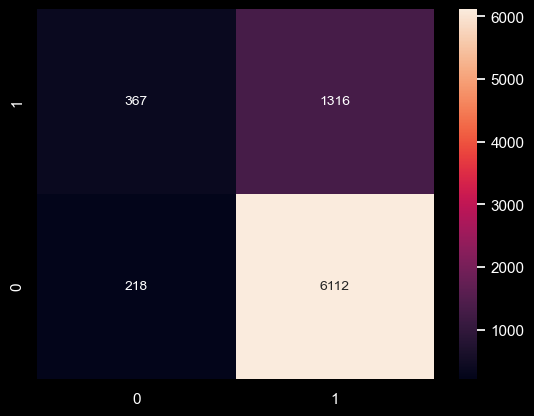

In [246]:
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 2. Decision Tree Classifier Model

In [247]:
model_dtc=DecisionTreeClassifier(max_depth=2,criterion='entropy',splitter='random')

In [248]:
model_dtc.fit(X_train,Y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=2, splitter='random')

In [249]:
model_dtc.score(X_train,Y_train)

0.7966192361185407

In [250]:
model_dtc.score(X_test,Y_test)  # Overfitting Controlled

0.8035692000499188

In [251]:
print("Training: {:6.2f}%".format(100*model_dtc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_dtc.score(X_test, Y_test)))

Training:  79.66%
Test set:  80.36%


<Axes: >

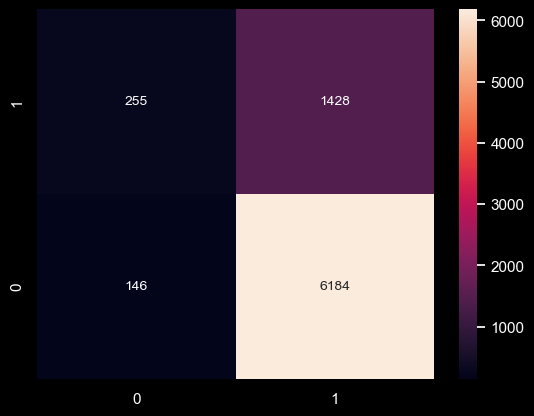

In [252]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_dtc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 3. Bagging Classifier Model

In [253]:
model_bc=BaggingClassifier(n_estimators=50,max_samples=0.9,base_estimator=model_dtc)

In [254]:
model_bc.fit(X_train,Y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy',
                                                        max_depth=2,
                                                        splitter='random'),
                  max_samples=0.9, n_estimators=50)

In [255]:
model_bc.score(X_train,Y_train)

0.786509040333797

In [256]:
model_bc.score(X_test,Y_test)  # Overfitting Controlled

0.7899663047547735

In [257]:
print("Training: {:6.2f}%".format(100*model_bc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_bc.score(X_test, Y_test)))

Training:  78.65%
Test set:  79.00%


<Axes: >

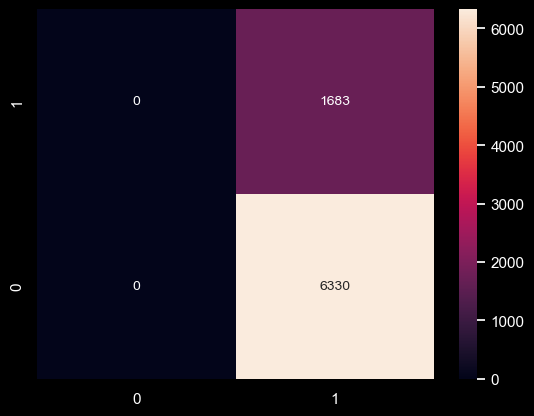

In [258]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_bc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 4. AdaBoost Classifier Model

In [259]:
model_abc=AdaBoostClassifier(n_estimators=50,base_estimator=model_dtc)

In [260]:
model_abc.fit(X_train,Y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy',
                                                         max_depth=2,
                                                         splitter='random'))

In [261]:
model_abc.score(X_train,Y_train)

0.8156627795014443

In [262]:
model_abc.score(X_test,Y_test)  # Overfitting Controlled

0.8146761512542119

In [263]:
print("Training: {:6.2f}%".format(100*model_abc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_abc.score(X_test, Y_test)))

Training:  81.57%
Test set:  81.47%


<Axes: >

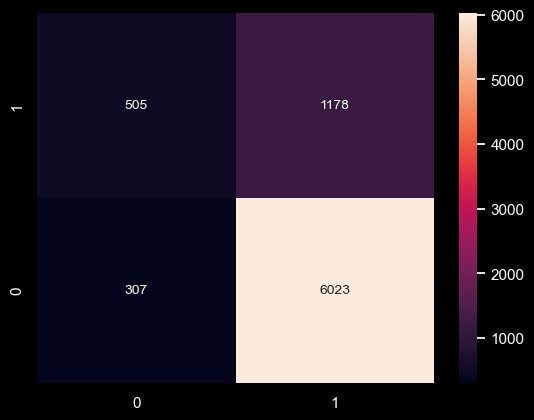

In [264]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_abc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 5. Gradient Boosting Classifier Model

In [265]:
model_gbc=GradientBoostingClassifier(n_estimators=100)

In [266]:
model_gbc.fit(X_train,Y_train)

GradientBoostingClassifier()

In [267]:
model_gbc.score(X_train,Y_train)

0.8193003102599765

In [268]:
model_gbc.score(X_test,Y_test) # Overfitting Controlled

0.8192936478222888

In [269]:
print("Training: {:6.2f}%".format(100*model_gbc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_gbc.score(X_test, Y_test)))

Training:  81.93%
Test set:  81.93%


<Axes: >

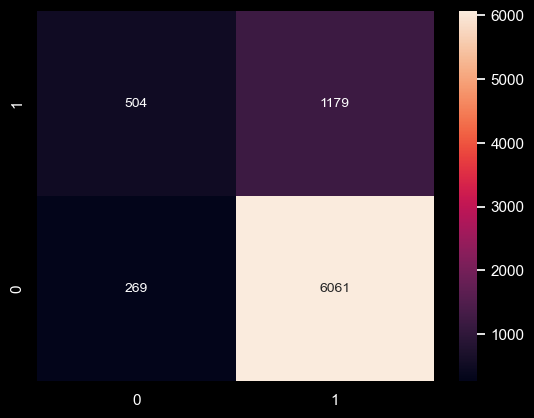

In [270]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_gbc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 6. Random Forest Classifier Model

In [271]:
model_rfc=RandomForestClassifier(n_estimators=100,max_depth=2)

In [272]:
model_rfc.fit(X_train,Y_train)

RandomForestClassifier(max_depth=2)

In [273]:
model_rfc.score(X_train,Y_train)

0.786509040333797

In [274]:
model_rfc.score(X_test,Y_test)  # Overfitting Controlled

0.7899663047547735

In [275]:
print("Training: {:6.2f}%".format(100*model_rfc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_rfc.score(X_test, Y_test)))

Training:  78.65%
Test set:  79.00%


<Axes: >

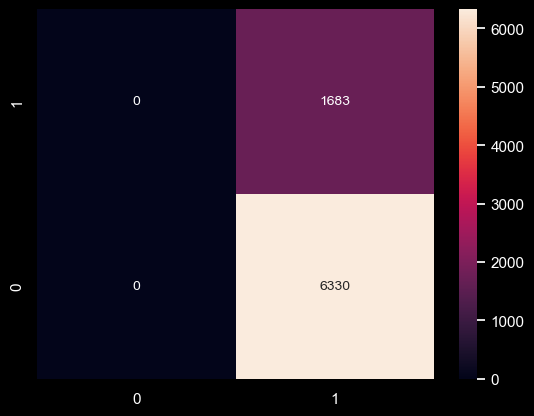

In [276]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_rfc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')

#### 7. Support Vector Classifier Model

In [277]:
model_svc=SVC(C=2.0)

In [278]:
model_svc.fit(X_train,Y_train)

SVC(C=2.0)

In [279]:
model_svc.score(X_train,Y_train)

0.786509040333797

In [280]:
model_svc.score(X_test,Y_test)  # Overfitting Controlled

0.7899663047547735

In [281]:
print("Training: {:6.2f}%".format(100*model_svc.score(X_train, Y_train)))
print("Test set: {:6.2f}%".format(100*model_svc.score(X_test, Y_test)))

Training:  78.65%
Test set:  79.00%


<Axes: >

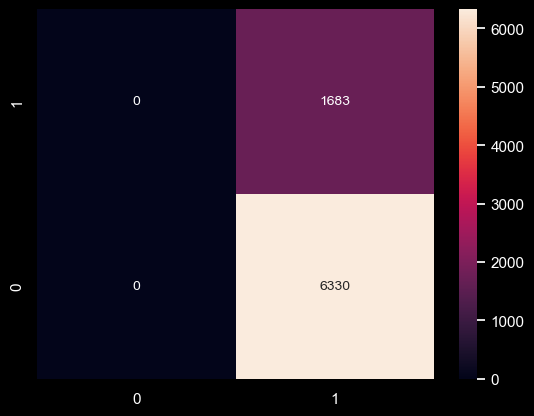

In [282]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
predictions=model_svc.predict(X_test)
from sklearn import metrics 
cm=metrics.confusion_matrix(Y_test,predictions,labels=[1,0])
df_cm=pd.DataFrame(cm,index=[i for i in ["1","0"]])
columns=[i for i in ["Predict1","Predict0"]]
sns.heatmap(df_cm,annot=True,fmt='g')